<a href="https://colab.research.google.com/github/visualdatabase/fastdup/blob/main/UAV_Drone_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## This tutorial shows how to use fastdup to filter out bad object detection bounding boxes on the UAV Drone Dataset.

# Download the UAV Dataset
This data contains drone taking videos of roads in China

In [1]:
!gdown 1m8KA6oPIRK_Iwt9TYFquC87vBc_8wRVc

Downloading...
From: https://drive.google.com/uc?id=1m8KA6oPIRK_Iwt9TYFquC87vBc_8wRVc
To: /content/UAV-benchmark-M.zip
100% 6.79G/6.79G [00:58<00:00, 116MB/s]


In [2]:
!gdown 19498uJd7T9w4quwnQEy62nibt3uyT9pq

Downloading...
From: https://drive.google.com/uc?id=19498uJd7T9w4quwnQEy62nibt3uyT9pq
To: /content/UAV-benchmark-MOTD_v1.0.zip
100% 246M/246M [00:01<00:00, 180MB/s]


In [3]:
!gdown 1qjipvuk3XE3qU3udluQRRcYuiKzhMXB1

Downloading...
From: https://drive.google.com/uc?id=1qjipvuk3XE3qU3udluQRRcYuiKzhMXB1
To: /content/M_attr.zip
100% 9.50k/9.50k [00:00<00:00, 12.7MB/s]


## Extract the data

In [4]:
!unzip -qq /content/UAV-benchmark-M.zip

replace UAV-benchmark-M/M0101/img000001.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


In [5]:
!unzip -qq /content/M_attr.zip

replace M_attr/readme.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


In [6]:
!unzip -qq /content/UAV-benchmark-MOTD_v1.0.zip

replace UAV-benchmark-MOTD_v1.0/CalculateDetectionsPR.m? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


In [7]:
!cat UAV-benchmark-MOTD_v1.0/README.md

This code library is for research purpose only, which is modifed based on the Milan et al.:
[1] A. Milan, L. Leal-Taix��, I. D. Reid, S., and K. Schindler. MOT16: A Benchmark for Multi-Object Tracking, in CoRR abs/1603.00831, 2016.

We distribute our library under the GNU-GPL license. If you use this library or the dataset, please cite our paper:
[2] D. Du, Y. Qi, H. Yu, Y. Yang, K. Duan, G. Li, W. Zhang, Q. Huang, and Q. Tian. The Unmanned Aerial Vehicle Benchmark: Object Detection and Tracking, in ECCV, 2018. 

The project website is https://sites.google.com/site/daviddo0323/ and the library will be updated on it.
If you have any questions, please contact us (email:cvdaviddo@gmail.com).

function CalculateTrakingAcc is used for evaluating the MOT methods
function CalculateDetectionsPR is used for evaluating the detection methods

MOT Groundtruth Format(*_gt.txt)

It looks as follows:

        <frame_index>,<target_id>,<bbox_left>,<bbox_top>,<bbox_width>,<bbox_height>,<score>,<in-view

## Read the bounding box annotations

In [8]:
import pandas as pd


In [9]:
ann.head()

,frame_id,target_id,bbox_l,bbox_t,bbox_w,bbox_h,out_of_view,occlusion,cat
0,723,1,539,214,15,14,1,1,1
1,724,1,538,214,15,14,1,1,1
2,725,1,538,215,15,14,1,1,1
3,726,1,538,216,15,14,1,1,1
4,727,1,538,217,15,14,1,1,1


## Show an example image

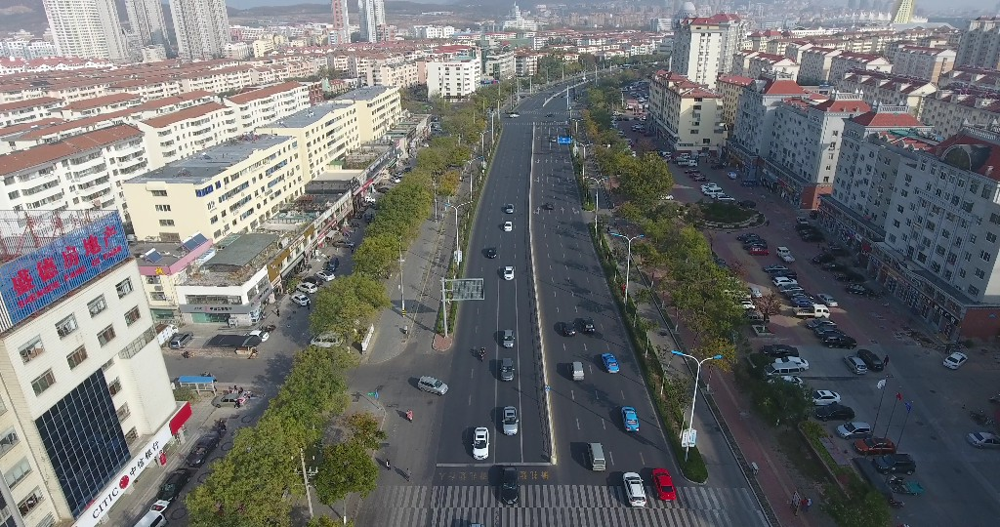

In [10]:
from IPython.display import Image
Image('./UAV-benchmark-M/M0606/img000275.jpg')

In [10]:
## Extract image patches out of the annotations as preperation for fastdup

In [44]:
from PIL import Image
import os
import cv2
import numpy as np
from tqdm import tqdm
!rm -fr output
!mkdir -p output

for video in os.listdir(f'./UAV-benchmark-M/'):
  ann = pd.read_csv(f'./UAV-benchmark-MOTD_v1.0/GT/{video}_gt_whole.txt', header=None)
  ann.columns = ['frame_id','target_id','bbox_l','bbox_t','bbox_w','bbox_h', 'out_of_view','occlusion','cat']
  for f in tqdm(os.listdir(f'./UAV-benchmark-M/{video}/')):
    img = cv2.imread(f'./UAV-benchmark-M/{video}/{f}')
    frame_int = int(f.replace('.jpg','').replace('img',''))
    subdf = ann[ann['frame_id'] == frame_int]
    for i in range(len(subdf)):
      row = subdf.values[i]
      target = row[1]
      top = row[2] #L
      left = row[3] #T
      width = row[4] #W
      height = row[5] #H
      img_array = np.array(img)
      w,h = img_array.shape[0], img_array.shape[1]
      try:
        ret = img_array[max(left-5,0):min(left+width+5,w),max(top-5,0):min(top+height+5,h)]
        cropped = Image.fromarray(ret)
        cropped.save(f'output/{video}_{frame_int}_{i}_{target}.jpg')
      except Exception as ex:
        print('Failed on row', row, w, h, ex)

100%|██████████| 445/445 [00:14<00:00, 30.67it/s]


# Run Fastdup to gain insights from the data

In [46]:
!pip install fastdup
import fastdup
fastdup.run('output', work_dir='result',turi_param='ccthreshold=0.9',num_images=100000)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
On Jupyter notebook running on large datasets, there may be delay getting the console output. We recommend running using python shell.


KeyboardInterrupt: ignored

# Examine groups of similar images. 
Assuming similar images represent the same tracked object from a video this is great. However if the tracked object id is not similar acros videos this is an issue. Filenames are of the type `video-id_frame-id_object-id`. Each car has its own `object_id`.

In [47]:
fastdup.create_components_gallery('result','.')

100%|██████████| 20/20 [00:03<00:00,  5.04it/s]


Finished OK. Components are stored as image files components{i}.png


100%|██████████| 20/20 [00:00<00:00, 36.78it/s]


Stored components visual view in  ./components.html


<Figure size 432x288 with 0 Axes>

,component_id,num_images,image
0,5419,19510,
1,3268,909,
2,6332,868,
3,17936,684,
4,23182,678,
5,44973,586,
6,10012,570,
7,33446,569,
8,18585,557,
9,40004,557,

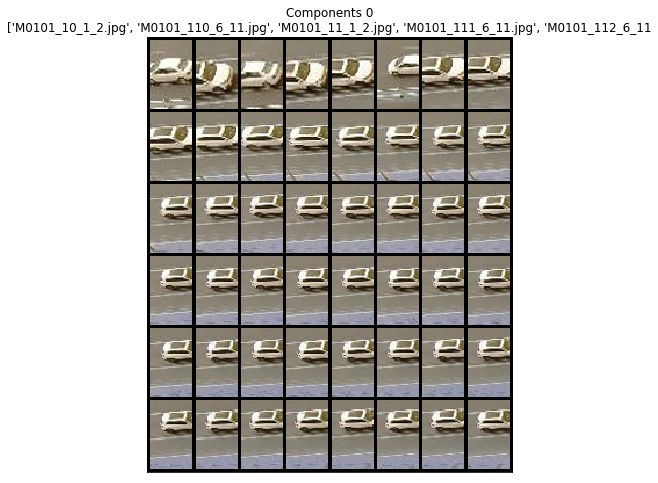
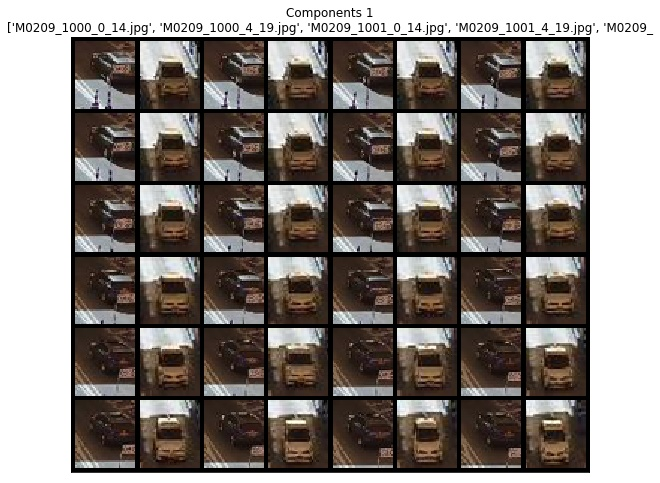
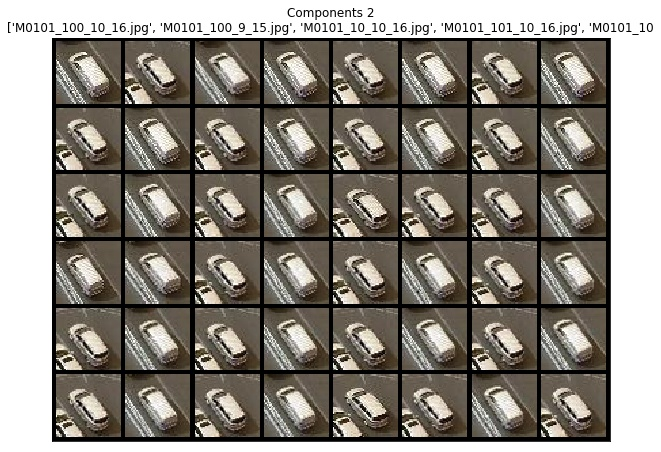
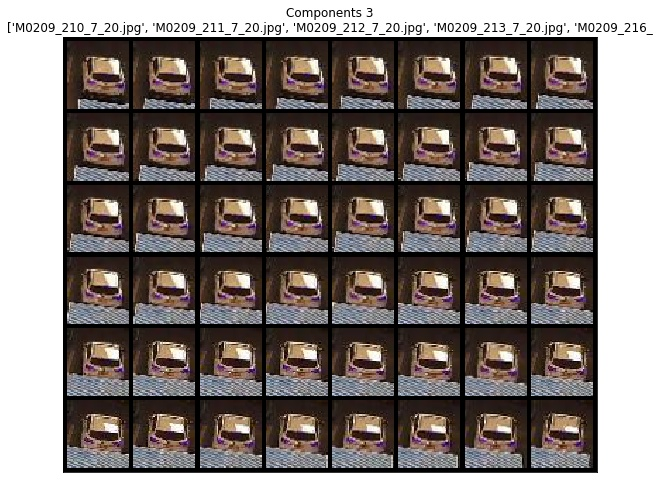
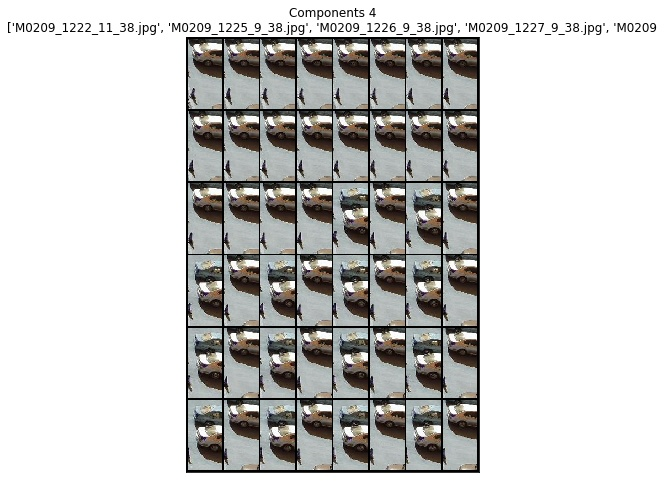
...
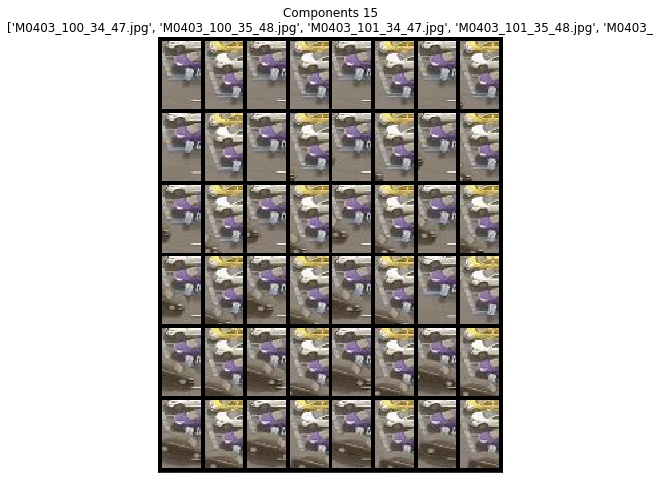
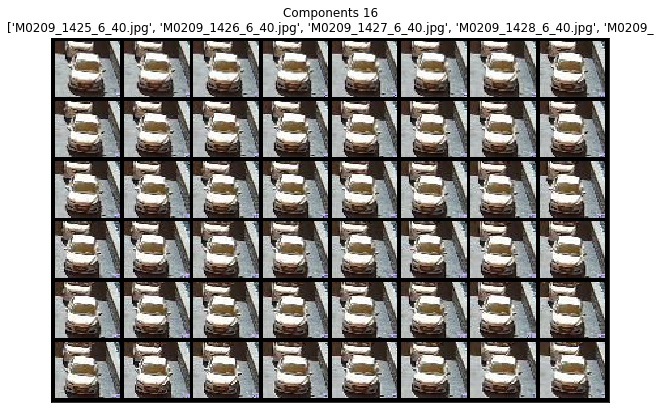
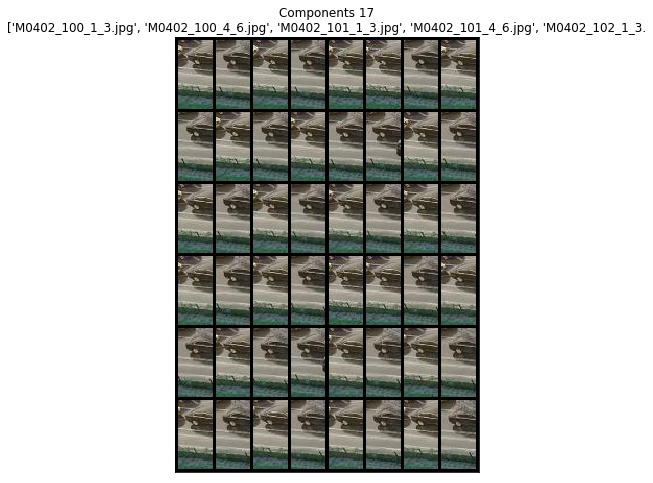
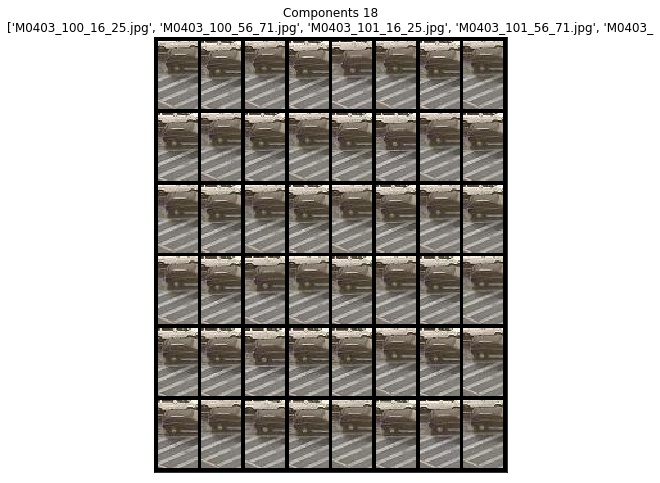
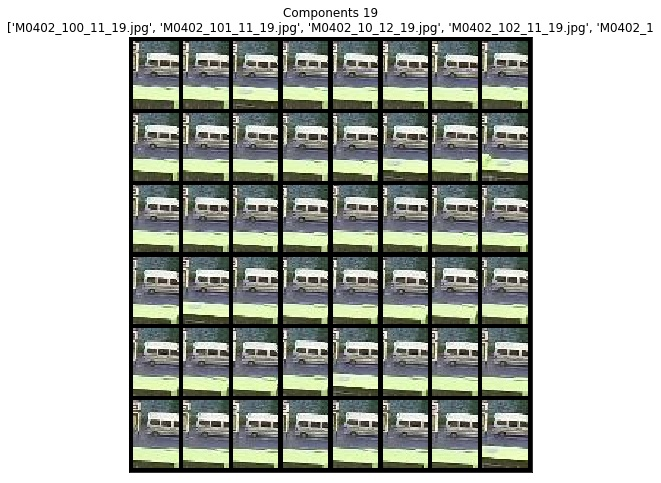

In [48]:
from IPython.display import HTML
HTML('./components.html')

## Look at patch outliers, most of them are not vehicles

In [49]:
outliers = pd.read_csv('result/outliers.csv')
outliers = outliers.tail(100).drop_duplicates(subset='from')
outliers.to_csv('outliers.csv')
fastdup.create_outliers_gallery('outliers.csv','.', num_images=100)

100%|██████████| 53/53 [00:00<00:00, 1287.86it/s]

Stored outliers visual view in  ./outliers.html


## The below outliers are images that are visually different than the typical image in this dataset

,Image,Distance,Path
52,,0.452887,output/M0210_468_15_34.jpg
51,,0.481641,output/M0210_498_16_34.jpg
50,,0.546789,output/M0210_421_14_34.jpg
49,,0.569606,output/M0210_484_15_34.jpg
48,,0.648239,output/M0204_136_2_10.jpg
47,,0.691291,output/M0202_108_11_16.jpg
46,,0.691643,output/M0402_344_1_2.jpg
45,,0.699878,output/M0205_590_1_19.jpg
44,,0.700281,output/M0204_223_3_8.jpg
43,,0.703244,output/M0205_89_1_4.jpg

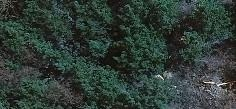
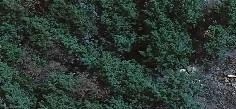
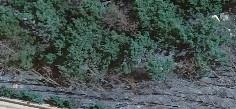
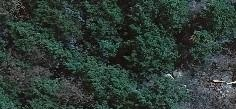
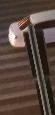
...
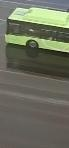
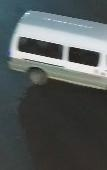
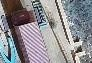
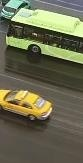
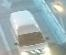

In [50]:
HTML('./outliers.html')

## Examine images that are too similar to each other, most of them indicate issues

In [51]:
fastdup.create_duplicates_gallery('result/similarity.csv','.')

100%|██████████| 20/20 [00:00<00:00, 242.15it/s]


Stored similarity visual view in  ./similarity.html


,Image,Distance,From,To
0,,0.995387,output/M0403_314_28_53.jpg,output/M0403_313_28_53.jpg
2,,0.995313,output/M0401_177_14_63.jpg,output/M0401_178_14_63.jpg
4,,0.995110,output/M0403_308_28_53.jpg,output/M0403_307_28_53.jpg
6,,0.994753,output/M0403_137_35_49.jpg,output/M0403_138_35_49.jpg
8,,0.994747,output/M0403_307_34_59.jpg,output/M0403_308_34_59.jpg
10,,0.994738,output/M0403_136_34_49.jpg,output/M0403_138_35_49.jpg
12,,0.994548,output/M0403_319_28_53.jpg,output/M0403_320_28_53.jpg
14,,0.994540,output/M0403_308_53_93.jpg,output/M0403_307_53_93.jpg
16,,0.994494,output/M0403_192_33_50.jpg,output/M0403_190_34_50.jpg
18,,0.994485,output/M0403_318_54_93.jpg,output/M0403_319_53_93.jpg

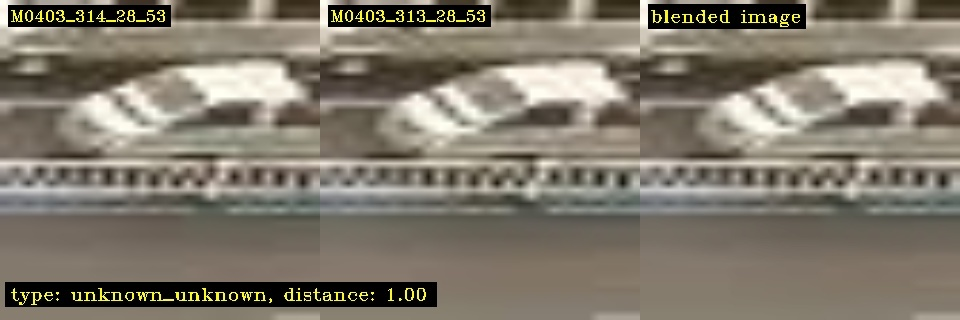
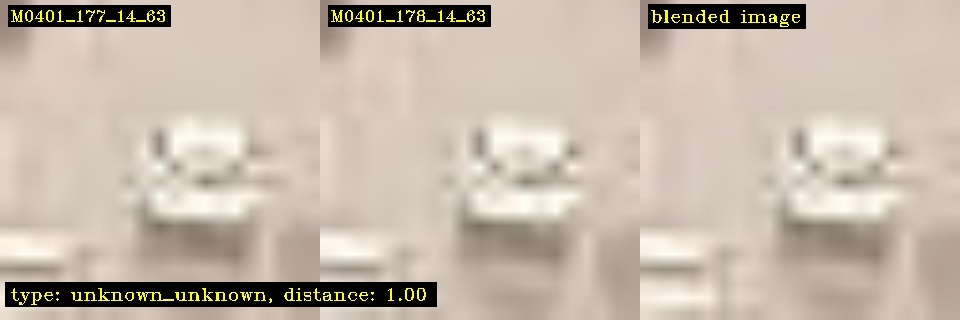
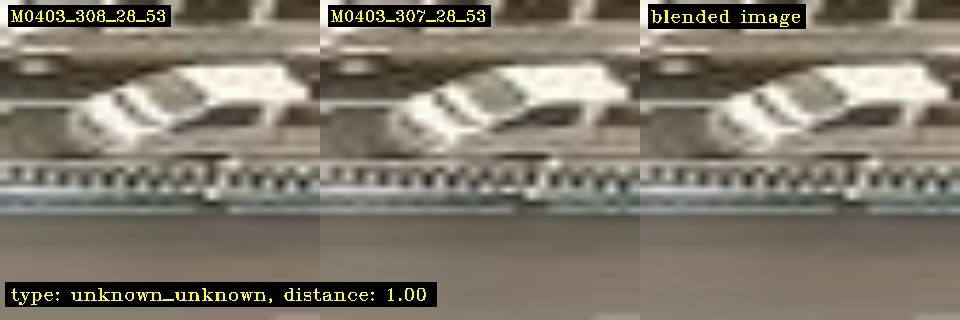
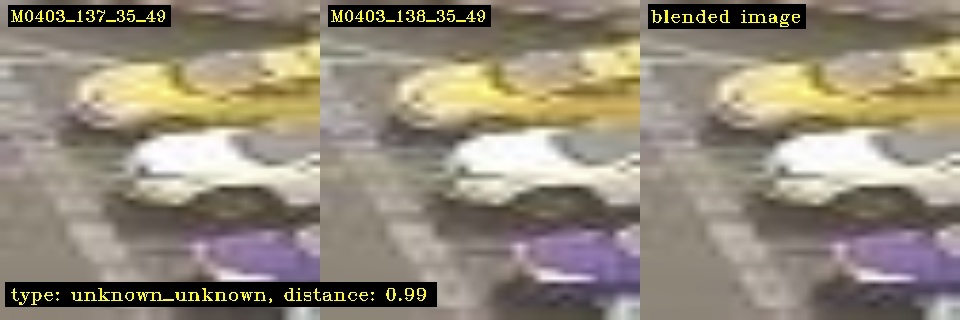
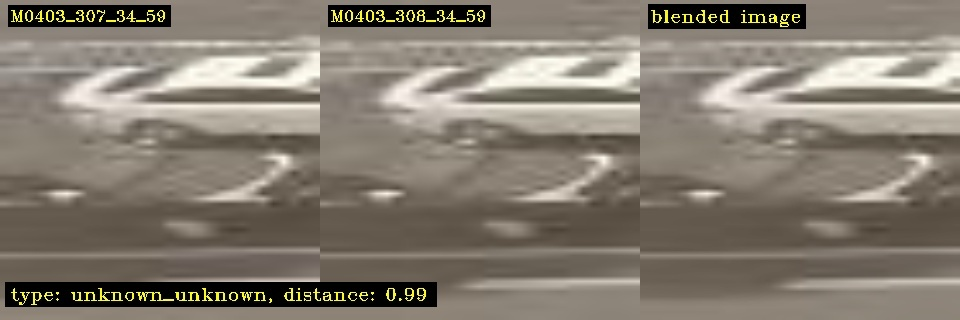
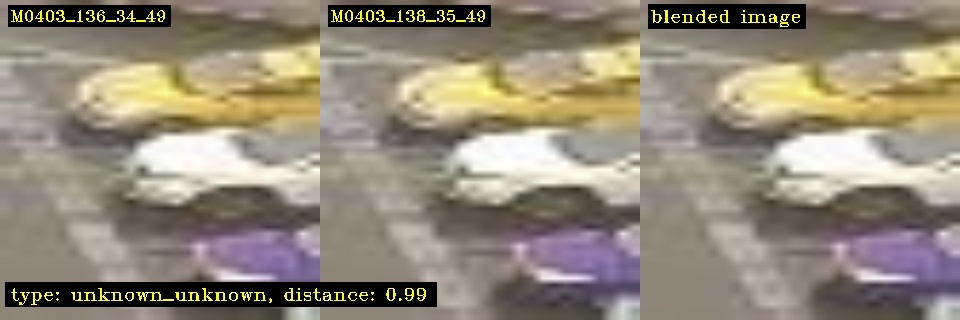
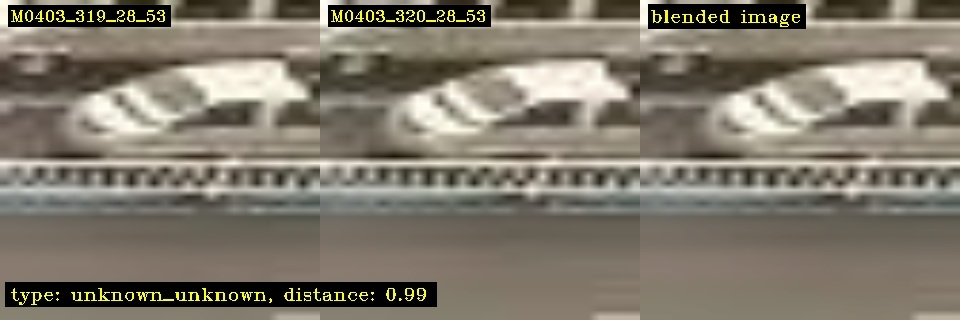
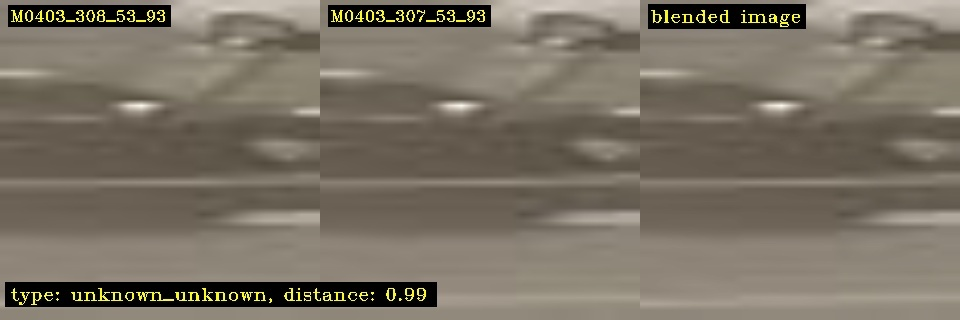
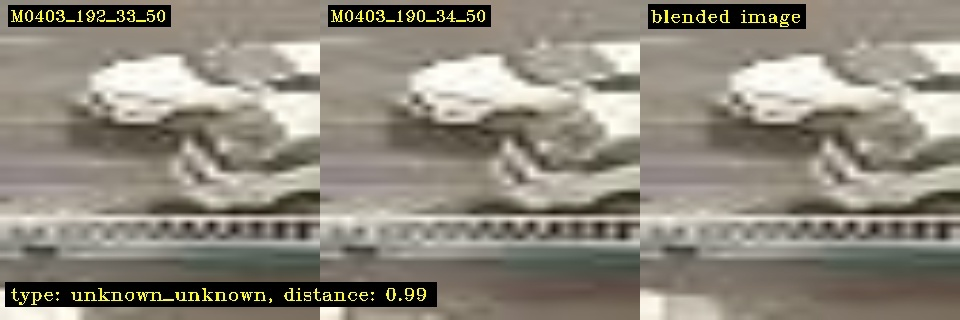
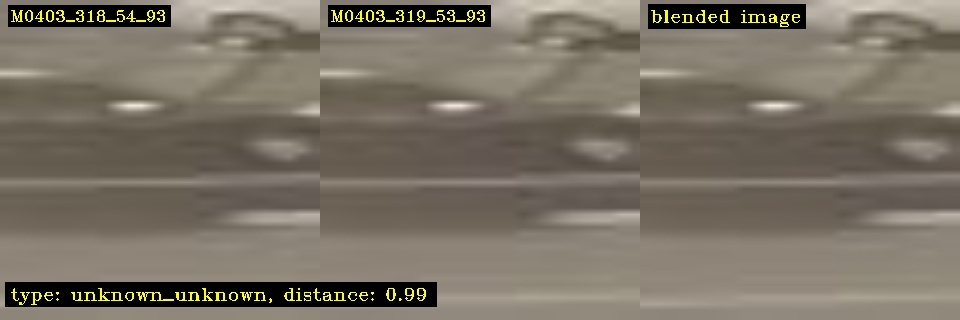

In [52]:
HTML('similarity.html')

In [57]:
sims = pd.read_csv('result/similarity.csv')
sims = sims[(sims['distance'] > 0.94) & (sims['distance'] < 0.96)]
sims.to_csv('similarity.csv')

100%|██████████| 20/20 [00:00<00:00, 153.72it/s]


Stored similarity visual view in  ./similarity.html


,Image,Distance,From,To
0,,0.959999,output/M0209_833_4_22.jpg,output/M0209_834_4_22.jpg
1,,0.959999,output/M0209_1083_0_14.jpg,output/M0209_1089_0_14.jpg
2,,0.959999,output/M0202_78_7_10.jpg,output/M0202_80_7_10.jpg
4,,0.959999,output/M0401_57_1_15.jpg,output/M0401_59_1_15.jpg
6,,0.959999,output/M0402_208_14_29.jpg,output/M0402_192_14_29.jpg
7,,0.959998,output/M0203_1005_0_2.jpg,output/M0203_1004_0_2.jpg
8,,0.959998,output/M0403_259_20_42.jpg,output/M0403_278_19_42.jpg
9,,0.959998,output/M0206_96_3_10.jpg,output/M0206_106_3_10.jpg
10,,0.959997,output/M0403_228_1_2.jpg,output/M0403_262_59_101.jpg
11,,0.959997,output/M0401_122_6_24.jpg,output/M0401_123_6_24.jpg

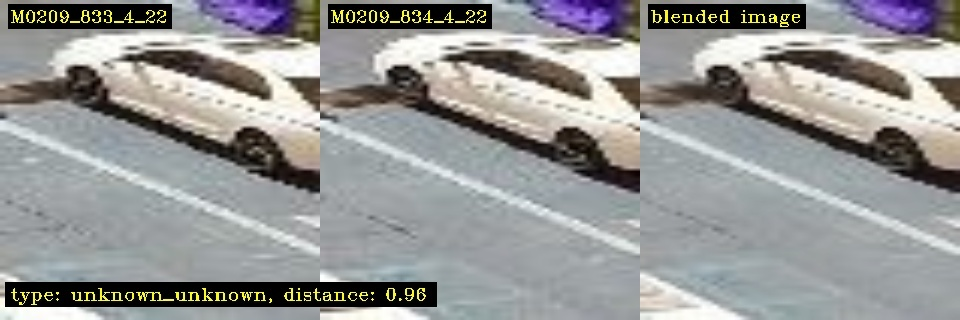
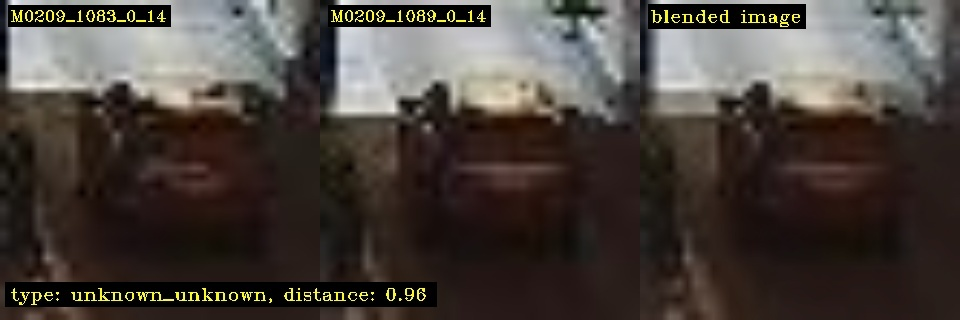
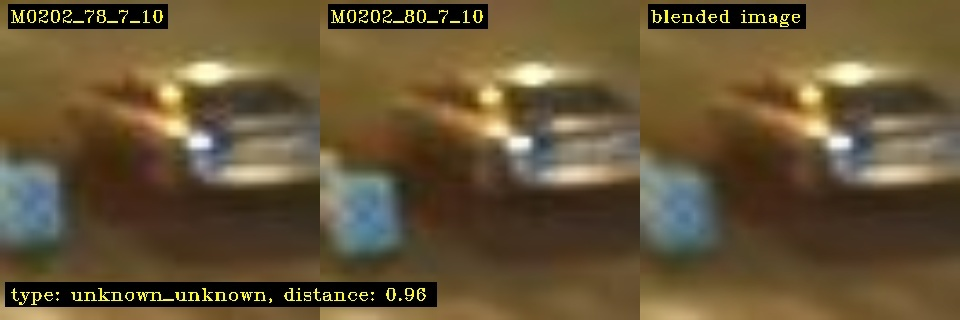
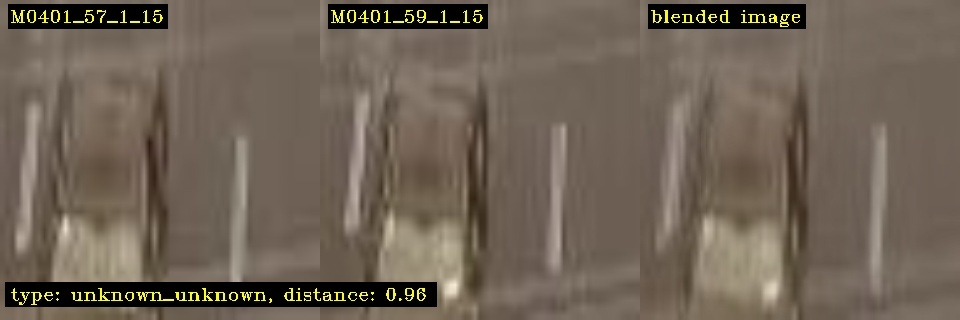
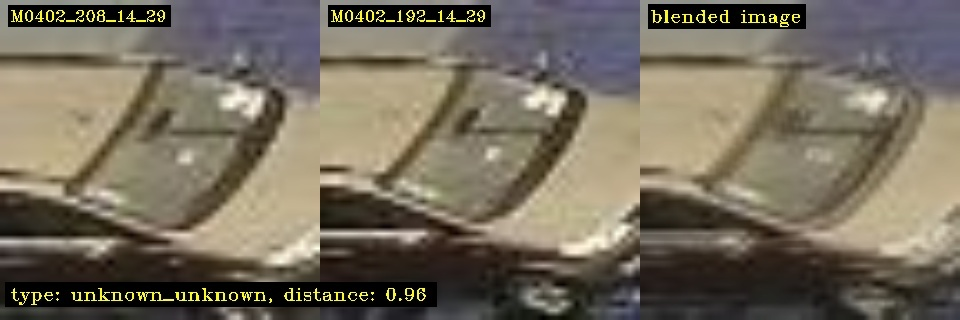
...
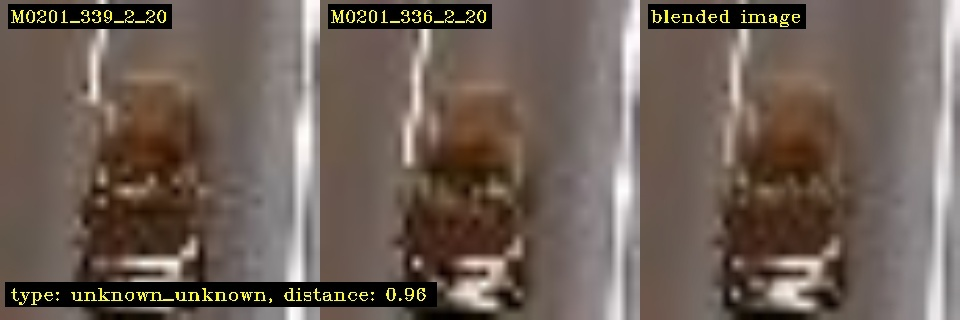
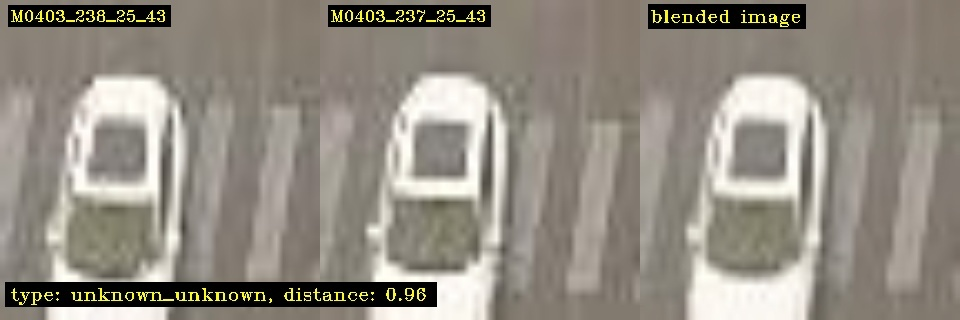
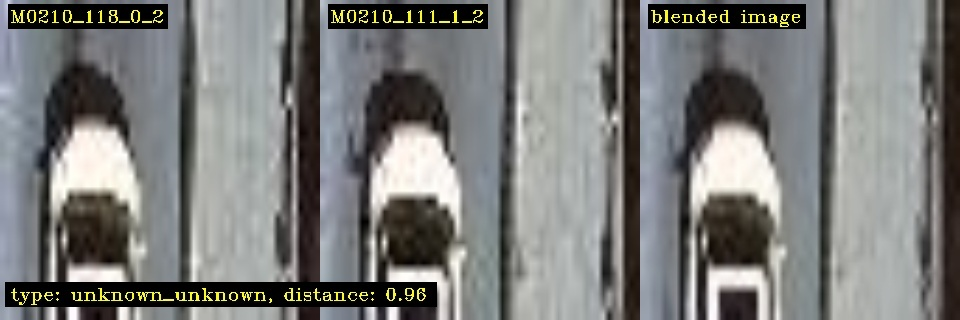
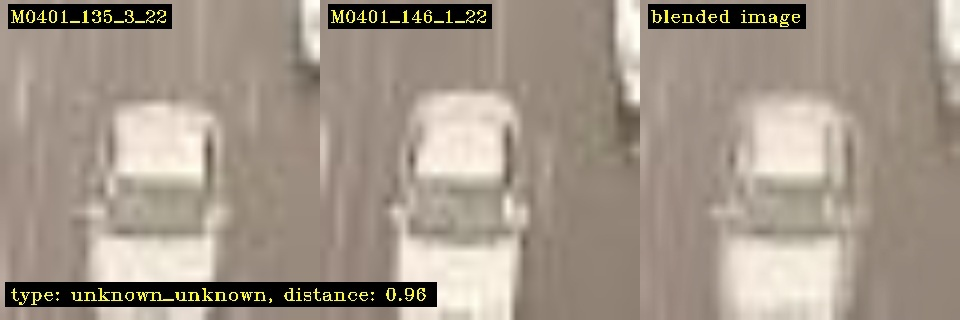
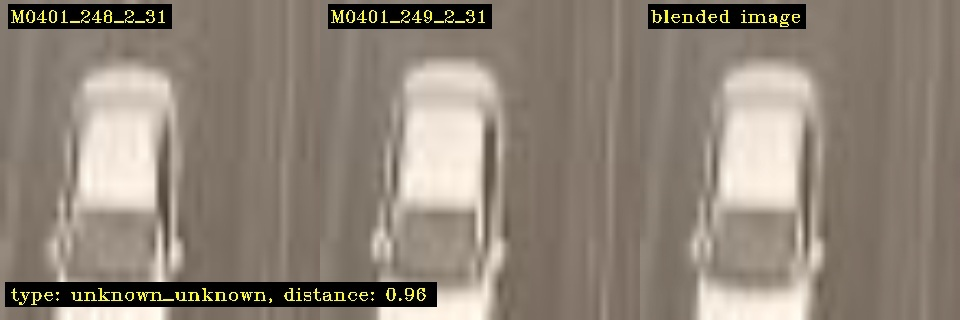

In [58]:
fastdup.create_duplicates_gallery('similarity.csv','.')
HTML('similarity.html')

# Explore data interactively using tensorboard projector

In [53]:
fastdup.export_to_tensorboard_projector('result','log') 

Read a total of  100000 images


100%|██████████| 900/900 [00:03<00:00, 252.62it/s]


Finish exporting to tensorboard projector, now run
%load_ext tensorboard
%tensorboard --logdir=log


In [ ]:
from IPython.display import Image
Image('log/sprite.png')

In [56]:
%load_ext tensorboard
%tensorboard --logdir=log

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1632), started 2:36:08 ago. (Use '!kill 1632' to kill it.)

<IPython.core.display.Javascript object>